In [16]:
%load_ext autoreload
%autoreload 2
import sys
import os

if not getattr(sys, "_src_path_added", False):
    src_path = os.path.abspath(os.path.join(os.getcwd(), ".."))
    if src_path not in sys.path:
        sys.path.insert(0, src_path)
    sys._src_path_added = True 

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [17]:
from MTGA.MTGA import *

from MTGA.MTGAInstance import Instance
import MTGA.Generators as Generators
import MTGA.Mutators as Mutators
import MTGA.WeightGenerators as WeightGenerators
import MTGA.GeneMutators as GeneMutators
import Fixers as Fixers
import Evaluators as Evaluators

from MTGA.GeneVisualizer import GeneEvolutionRenderer
from Displayer import Displayer

from Utils import *
from MTGA.MTGAUtils import *

## Main Instance

In [18]:
instance = Instance("../problems/p1.json",
    evaluator=Evaluators.CummulativeEvaluator(),
    mutator=Mutators.WalkMutator(),
    generator=Generators.TruncatedNormal(),
    fixer=Fixers.ChoiceFixer(),
    weight_generator=WeightGenerators.SoftmaxWeights(),
    gene_mutator=GeneMutators.Normal())

problem size 10
fire starts [2]
num teams 4


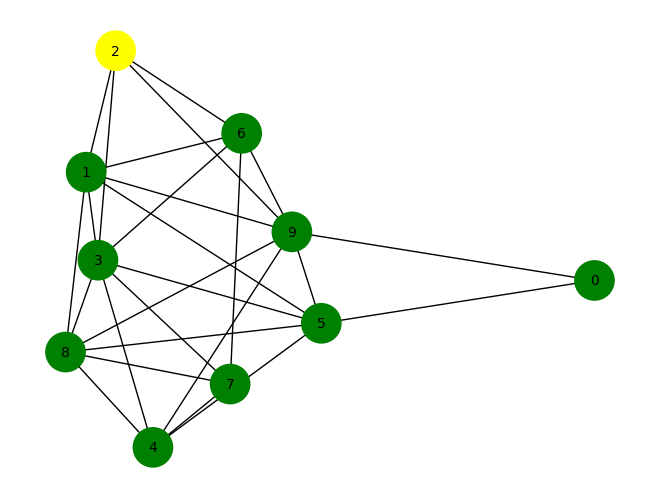

In [19]:
print("problem size", instance.size)
print("fire starts", instance.problem.fire_starts)
print("num teams", instance.problem.num_teams)
draw_graph(instance.problem)

In [20]:
displayer = Displayer()
gene_displayer = GeneEvolutionRenderer()

## The Run

In [21]:
data = optimize_and_collect(instance)

[2025-02-09 18:22:49][  0]     0.60644126     0.60608578 {  1.00000000   5.24600000  50.00000000   5.77420852}
[2025-02-09 18:22:50][  1]     1.04869747     0.39570785 {  1.00000000   5.80400000  50.00000000   7.15580771}
[2025-02-09 18:22:50][  2]     1.43675900     0.32793045 {  1.00000000   6.54600000  50.00000000   8.39475336}
[2025-02-09 18:22:50][  3]     1.79393649     0.34624887 {  1.00000000   6.97800000  50.00000000   8.53894115}
[2025-02-09 18:22:51][  4]     2.20647621     0.39843082 {  1.00000000   8.04600000  50.00000000  10.14474662}
[2025-02-09 18:22:51][  5]     2.71759820     0.49971533 {  1.00000000   8.72400000  50.00000000  10.09850603}
[2025-02-09 18:22:52][  6]     3.20882726     0.47666001 {  1.00000000  12.28000000  50.00000000  14.95291276}
[2025-02-09 18:22:52][  7]     3.66747022     0.44330430 {  1.00000000  12.01000000  50.00000000  14.51433429}
[2025-02-09 18:22:53][  8]     4.12084484     0.44021082 {  1.00000000  15.36200000  50.00000000  17.38191462}
[

In [22]:
solutions = correct_solutions(instance)

## Results

In [23]:
best_solution, best_solutions_value = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value}]:\n{best_solution}")

Best solution [5]:
[1, 3, 6, 9]


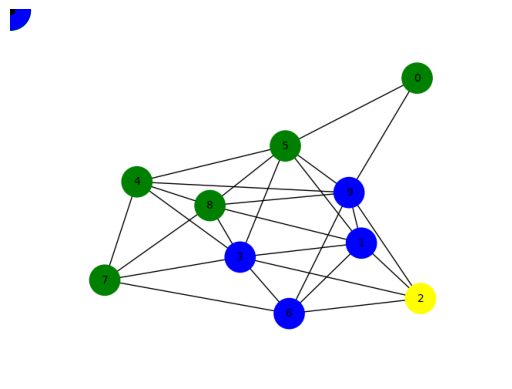

In [24]:
instance.problem.visualize_fire_without_burned(displayer, best_solution)

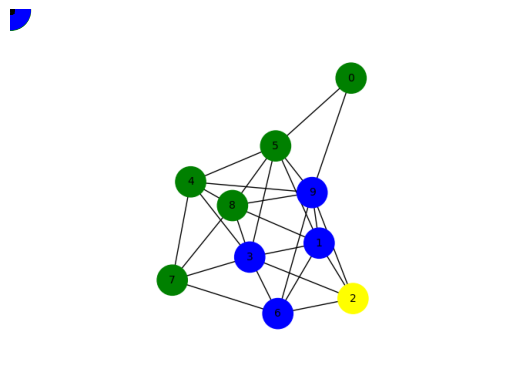

In [25]:
instance.problem.visualize_fires(displayer, solutions)

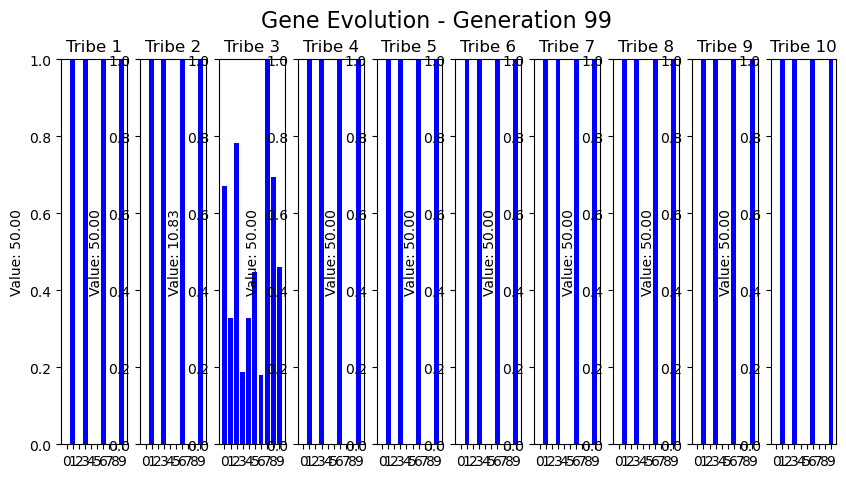

In [26]:
gene_displayer.visualize(data)

## Instance 200

data collected


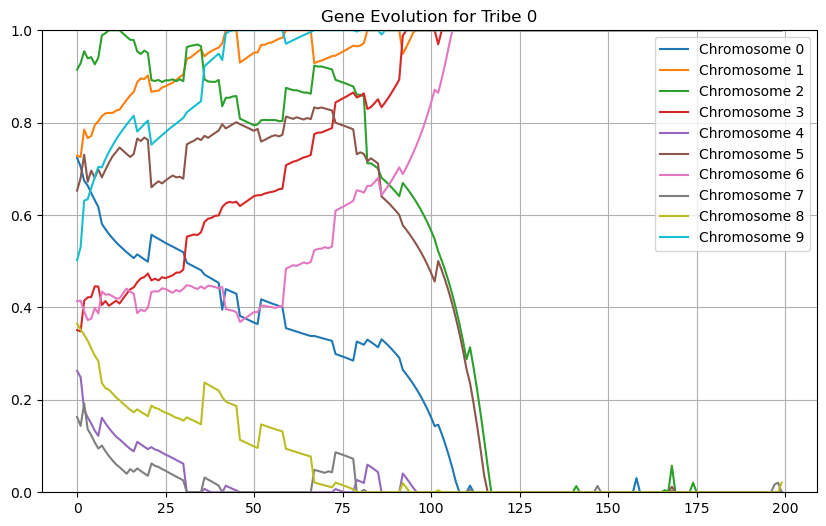

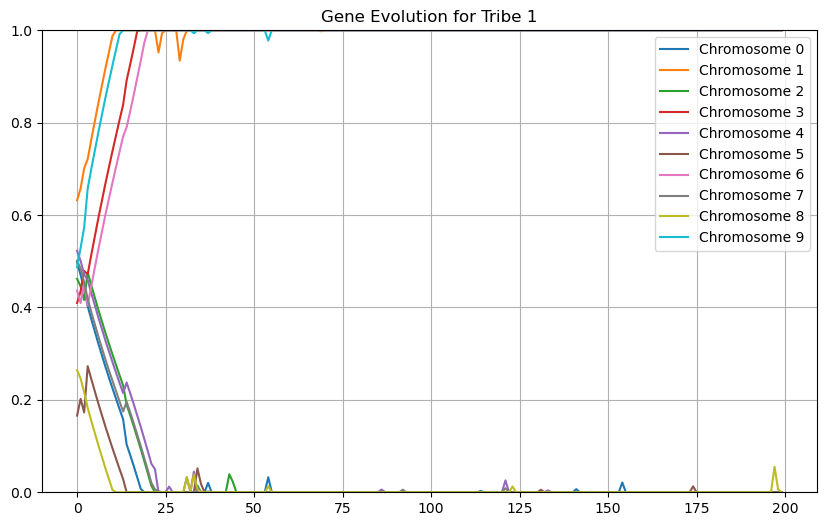

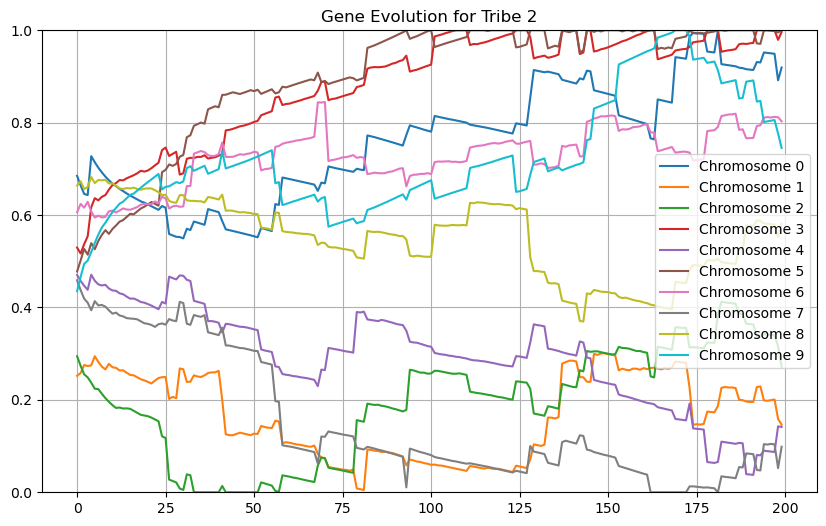

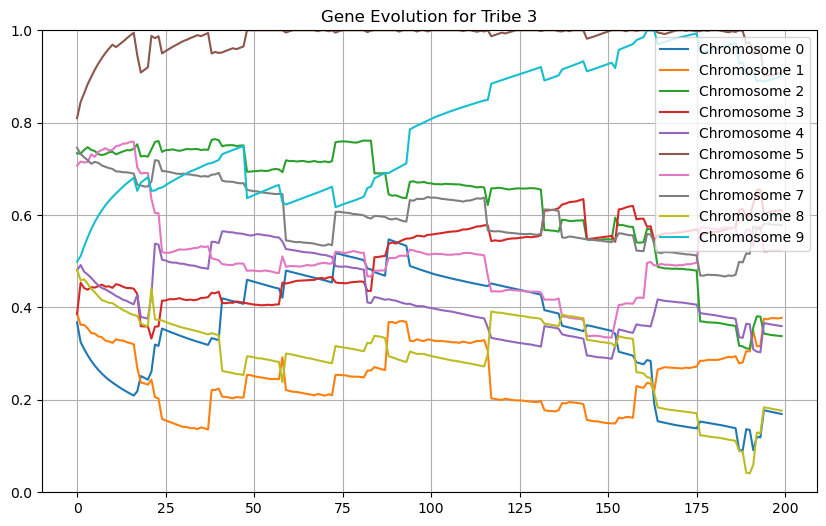

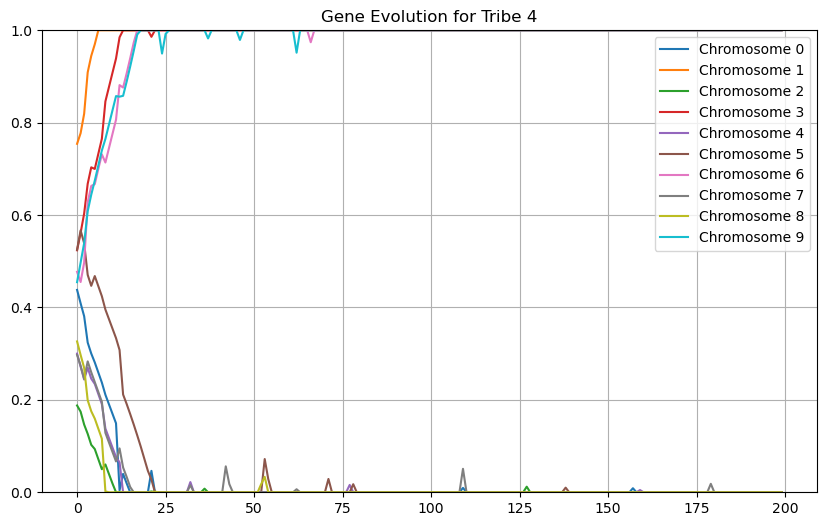

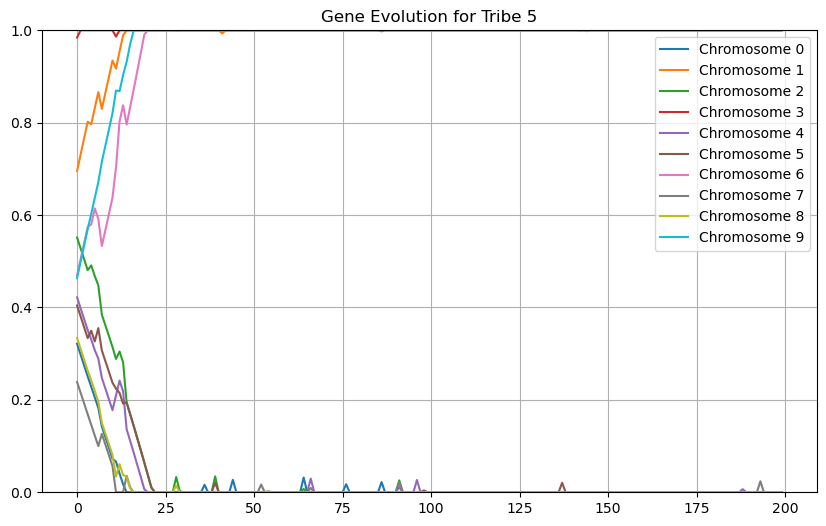

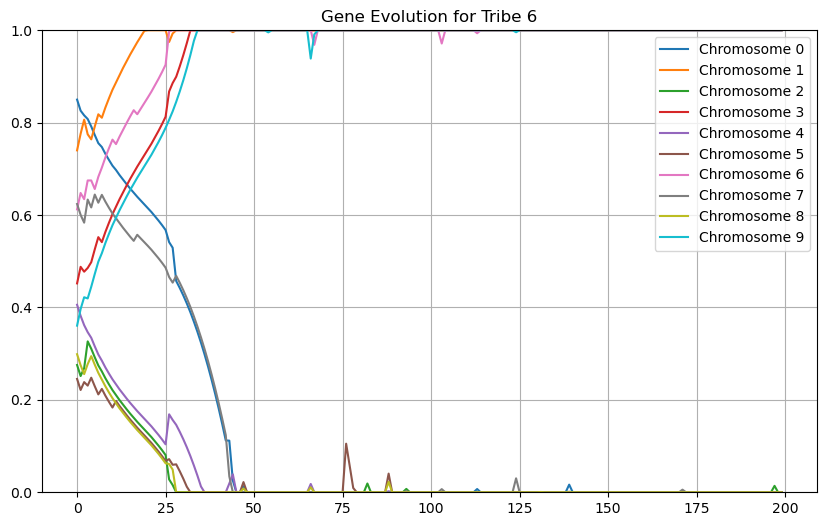

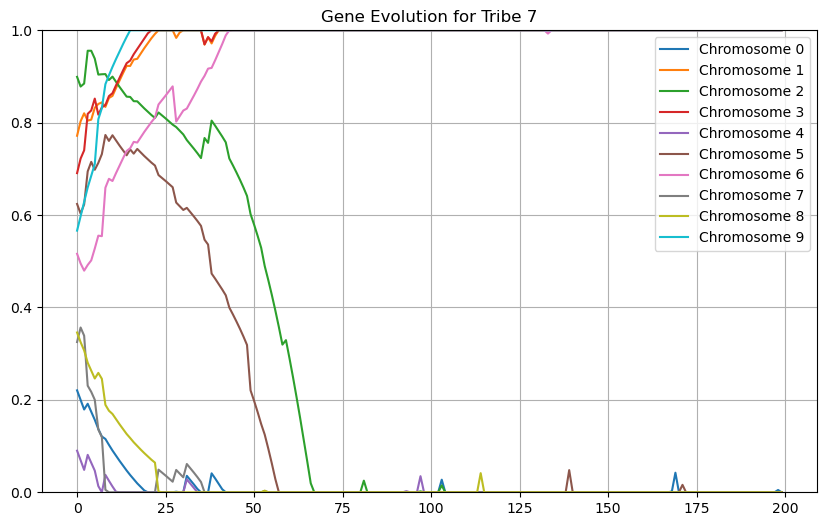

In [27]:
data200, instance200 = collect_and_visualize("../problems/p1.json", local_step_size=0.03, sigma=0.04)

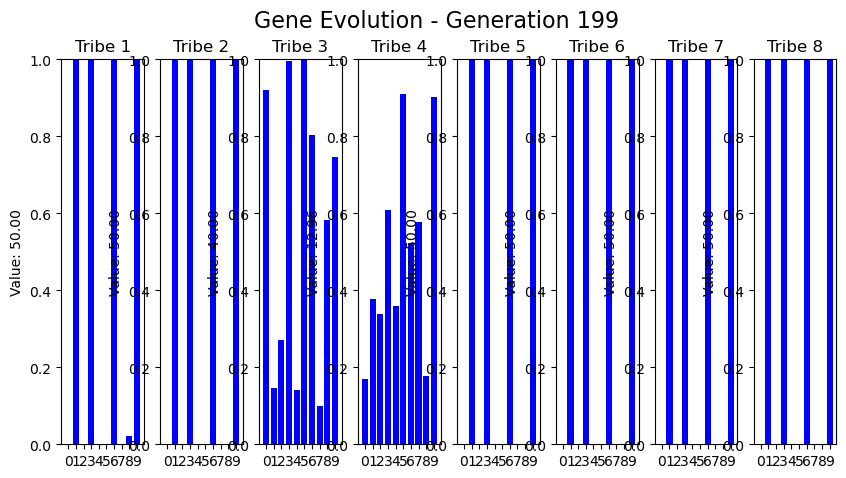

In [28]:
gene_displayer.visualize(data200)

In [29]:
solutions = correct_solutions(instance200)

In [30]:
best_solution_200, best_solutions_value_200 = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value_200}]:\n{best_solution_200}")

Best solution [5]:
[1, 3, 6, 9]
